# EffecientNet B2 Modles Analysis

In [ ]:
import json
import os
import sys
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from PIL import Image
from tqdm import tqdm
from torchvision.models import efficientnet_b2
import matplotlib.patches as patches
import torch.nn as nn
from torch.utils.data import DataLoader
import torch
import matplotlib.pyplot as plt
from collections import Counter

from torchvision import transforms
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc

import matplotlib.pyplot as plt
%matplotlib inline

# importing malaria dataset class to map bounding boxes on one image
# and skipping any null values with detection collate
parent_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(parent_dir)
from malaria_dataset import MalariaDataset, detection_collate


In [ ]:
root_path = os.path.join('..', 'dataset', 'malaria')
image_path = os.path.join('..','dataset','malaria','images')

# using the stratified 
train_json_path = os.path.join(root_path, 'training_stratified.json')
test_json_path = os.path.join(root_path, 'test_stratified.json')

models_dir = os.path.join('efficientnet_models')
results_path = os.path.join(models_dir,'grid_search_results.json')

In [3]:
def cells_count(training_dataset_json):
    # Loading the JSON
    with open(training_dataset_json, 'r') as f:
        training_metadata = json.load(f)

    # Extracting all object categories into a list
    all_categories = []
    for item in training_metadata:
        for obj in item['objects']:
            all_categories.append(obj['category'])

    # Create DataFrame and count categories
    df = pd.DataFrame(all_categories, columns=['category'])
    category_counts = df['category'].value_counts()

    return category_counts.to_dict()

# Example usage
# train_json_path = r"D:\fyp\fyp\train.json"
counts = cells_count(train_json_path)
print(counts)
counts2 = cells_count(test_json_path)
print(counts2)


{'red blood cell': 76165, 'trophozoite': 1416, 'difficult': 430, 'ring': 349, 'schizont': 178, 'gametocyte': 142, 'leukocyte': 82}
{'red blood cell': 6869, 'ring': 173, 'trophozoite': 168, 'leukocyte': 21, 'difficult': 16, 'gametocyte': 14, 'schizont': 12}


In [5]:
# Function to count entries in a JSON file
def count_json_entries(file_path):
    if not os.path.exists(file_path):
        print(f"Error: The file path '{file_path}' does not exist.")
        return 0
    
    with open(file_path, 'r') as f:
        data = json.load(f)
    
    # Assuming the JSON data is a list of entries
    return len(data)

# Count entries in each file
train_count = count_json_entries(train_json_path)
test_count = count_json_entries(test_json_path)

# Print the results
print(f"Number of entries in training.json: {train_count}")
print(f"Number of entries in test.json: {test_count}")

Number of entries in training.json: 1190
Number of entries in test.json: 138


In [6]:
# Load the grid search results
with open(results_path, 'r') as f:
    all_results = json.load(f)

# Convert to a DataFrame for easy analysis
results_df = pd.DataFrame(all_results)

# The 'params' column is a dictionary, let's expand it for better sorting
params_df = pd.json_normalize(results_df['params'])
results_df = pd.concat([results_df.drop('params', axis=1), params_df], axis=1)

# Sort by accuracy to find the best run
results_df = results_df.sort_values(by='best_accuracy', ascending=False).reset_index(drop=True)

print("--- Top 5 Performing Models ---")
display(results_df.head())

--- Top 5 Performing Models ---


,best_accuracy,training_time_minutes,history,lr,optimizer,batch_size,sampling,image_size
0,94.799054,47.760783,"{'train_loss': [9.133223307760138, 8.397412940...",0.0010,Adam,32,oversample,224
1,94.799054,25.002517,"{'train_loss': [16.83139763380352, 15.91469799...",0.0010,Adam,32,oversample,128
2,94.799054,48.497283,"{'train_loss': [9.836383957611886, 8.620703860...",0.0010,SGD,32,oversample,224
3,94.799054,48.624517,"{'train_loss': [9.700505482523065, 8.685548355...",0.0010,SGD,32,none,224
4,94.799054,27.238550,"{'train_loss': [17.683489924982975, 16.0491562...",0.0001,Adam,32,none,128


## Plotting scores

In [7]:
def plot_training_history(history, params):
    """
    Plots the training and validation loss and accuracy curves from a history dictionary.
    """
    fig, ax = plt.subplots(1, 2, figsize=(20, 7))
    
    # Create an array for the x-axis (epochs)
    epochs = range(1, len(history['train_loss']) + 1)

    # --- Plot 1: Loss vs. Epochs ---
    ax[0].plot(epochs, history['train_loss'], label='Train Loss', color='royalblue', marker='o', linestyle='--')
    ax[0].plot(epochs, history['val_loss'], label='Validation Loss', color='darkorange', marker='o')
    ax[0].set_title('Loss Over Epochs', fontsize=16)
    ax[0].set_xlabel('Epoch', fontsize=12)
    ax[0].set_ylabel('Loss', fontsize=12)
    ax[0].legend()
    ax[0].grid(True, which='both', linestyle=':', linewidth=0.5)

    # --- Plot 2: Accuracy vs. Epochs ---
    ax[1].plot(epochs, history['train_accuracy'], label='Train Accuracy', color='royalblue', marker='s', linestyle='--')
    ax[1].plot(epochs, history['val_accuracy'], label='Validation Accuracy', color='green', marker='s')
    ax[1].set_title('Accuracy Over Epochs', fontsize=16)
    ax[1].set_xlabel('Epoch', fontsize=12)
    ax[1].set_ylabel('Accuracy (%)', fontsize=12)
    ax[1].legend()
    ax[1].grid(True, which='both', linestyle=':', linewidth=0.5)

    # Create a comprehensive title for the entire figure
    param_str = ', '.join([f'{k}={v}' for k, v in params.items()])
    fig.suptitle(f'Training History for Best Model: {param_str}', fontsize=20)
    
    # Adjust layout to prevent title overlap
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

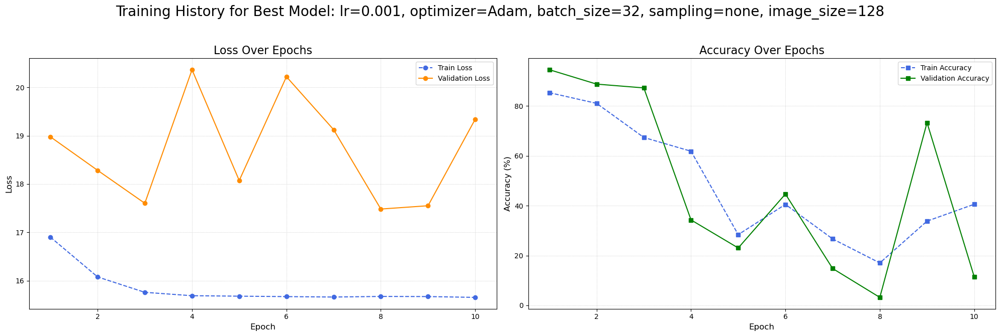

In [8]:
# The history is a string in the JSON, so we need to get it from the original list
best_run_dict = all_results[results_df.index[0]]
best_history = best_run_dict['history']
best_params = best_run_dict['params']

plot_training_history(best_history, best_params) 

In [9]:
def plot_all_grid_search_results(all_results):
    """
    Plots the validation loss and accuracy for all experiments from a grid search on a single graph.
    """
    fig, ax = plt.subplots(1, 2, figsize=(24, 10))
    
    # Define styles to cycle through to make lines distinguishable
    linestyles = ['-', '--', ':', '-.']
    markers = ['o', 's', 'v', '^', 'D', '<', '>', 'p']
    # Generate a list of distinct colors
    colors = plt.get_cmap('tab20', len(all_results))

    # --- Loop through each experiment's results ---
    for i, result in enumerate(all_results):
        history = result['history']
        params = result['params']
        
        # Create a short, descriptive label for the legend
        samp_char = 'O' if params.get('sampling', 'none') == 'oversample' else 'N'
        label = f"Run {i+1}: lr={params['lr']}, optim={params['optimizer'][:3]}, size={params['image_size']}, samp={samp_char}"

        epochs = range(1, len(history['val_loss']) + 1)
        
        # Get unique styles for the plot
        style = linestyles[i % len(linestyles)]
        marker = markers[i % len(markers)]
        color = colors(i)

        # --- Plot 1: Validation Loss vs. Epochs ---
        ax[0].plot(epochs, history['val_loss'], label=label, color=color, linestyle=style, marker=marker, markersize=5)
        
        # --- Plot 2: Validation Accuracy vs. Epochs ---
        ax[1].plot(epochs, history['val_accuracy'], label=label, color=color, linestyle=style, marker=marker, markersize=5)

    # --- Formatting for the Loss Plot ---
    ax[0].set_title('Validation Loss Comparison', fontsize=18)
    ax[0].set_xlabel('Epoch', fontsize=14)
    ax[0].set_ylabel('Loss', fontsize=14)
    ax[0].grid(True, which='both', linestyle=':', linewidth=0.7)
    
    # --- Formatting for the Accuracy Plot ---
    ax[1].set_title('Validation Accuracy Comparison', fontsize=18)
    ax[1].set_xlabel('Epoch', fontsize=14)
    ax[1].set_ylabel('Accuracy (%)', fontsize=14)
    ax[1].grid(True, which='both', linestyle=':', linewidth=0.7)
    
    # --- Create a single, shared legend outside the plot area ---
    handles, labels = ax[1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1.0, 0.5), fontsize=12, title="Experiments")

    # --- Overall Figure Title and Layout Adjustment ---
    fig.suptitle('Comparison of All 16 Grid Search Experiments', fontsize=24)
    fig.tight_layout(rect=[0, 0, 0.85, 0.96]) # Adjust layout to make space for the legend and title
    
    plt.show()

Plotting a comparison of all 16 experiments...


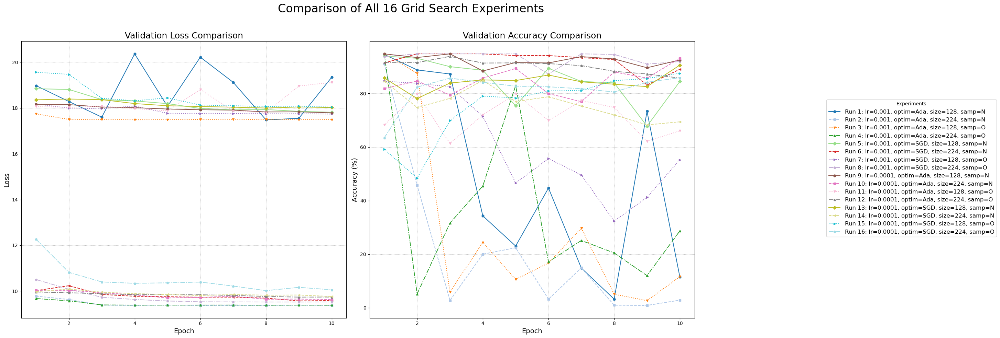

In [10]:
print(f"Plotting a comparison of all {len(all_results)} experiments...")

# Call the new function with your complete results
plot_all_grid_search_results(all_results)

In [11]:
class EfficientNetDetector(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.backbone = efficientnet_b2(weights='IMAGENET1K_V1')
        # Replace the final fully connected layer
        num_features = self.backbone.classifier[1].in_features
        self.backbone.classifier = nn.Identity() # Remove the original classifier

        # New heads for your task
        self.classifier = nn.Linear(num_features, num_classes)
        self.bbox_head = nn.Linear(num_features, 4)

    def forward(self, x):
        features = self.backbone(x)
        class_scores = self.classifier(features)
        bbox_preds = self.bbox_head(features)
        return class_scores, bbox_preds

In [12]:
def validate_model(model, val_loader, device, image_size, return_preds=False):
    all_labels = []
    all_preds = []
    all_scores = []
    model.eval()
    running_loss, correct, total = 0.0, 0, 0
    with torch.no_grad():
        for images, targets_list in tqdm(val_loader, desc="Validating", unit="batch"):
            images = images.to(device)
            class_scores, bbox_preds = model(images)

            for i in range(images.size(0)):
                target = targets_list[i]
                target_labels = target['labels'].to(device)
                
                if len(target_labels) == 0: continue
                
                # --- (Loss and accuracy logic remains the same) ---
                # This part is fine for training, as it considers all objects
                target_boxes = target['boxes'].to(device)
                target_boxes_norm = target_boxes / torch.tensor([image_size, image_size, image_size, image_size], device=device)
                loss = margin_loss(class_scores[i].unsqueeze(0), target_labels) + 0.1 * bbox_loss(bbox_preds[i], target_boxes_norm)
                running_loss += loss.item()
                predicted = torch.argmax(class_scores[i])
                correct += (predicted == target_labels).sum().item()
                total += len(target_labels)
                # --- End of original logic ---

                # --- NEW, ROBUST LOGIC FOR THE REPORT ---
                # Check if there are any parasite labels in the list.
                # Assumes 'red blood cell' is label 3 and 'leukocyte' is label 2. Adjust if necessary.
                parasite_labels = [lbl for lbl in target_labels if lbl.item() not in [2, 3]] # Find any label that isn't a leukocyte or RBC

                if parasite_labels:
                    # If parasites exist, use the first parasite label as the ground truth.
                    true_label_for_report = parasite_labels[0].cpu().item()
                else:
                    # Otherwise, the ground truth is the first label (which will be an RBC or leukocyte).
                    true_label_for_report = target_labels[0].cpu().item()
                
                all_labels.append(true_label_for_report)
                all_preds.append(predicted.cpu().item())
                
                scores = F.softmax(class_scores[i], dim=0)
                all_scores.append(scores.cpu().numpy())

    epoch_loss = running_loss / len(val_loader) if len(val_loader) > 0 else 0
    accuracy = 100 * correct / total if total > 0 else 0
    print(f"Validation Loss: {epoch_loss:.4f}, Accuracy: {accuracy:.2f}%")

    if return_preds:
        return epoch_loss, accuracy, all_labels, all_preds, all_scores
    else:
        return epoch_loss, accuracy

In [ ]:
def margin_loss(class_scores, targets, margin=0.2):
    one_hot_targets = F.one_hot(targets.long(), num_classes=class_scores.size(-1)).float()
    left = F.relu(margin - class_scores) * one_hot_targets
    right = F.relu(class_scores - (1 - margin)) * (1.0 - one_hot_targets)
    return (left + right).sum(dim=-1).mean()

def bbox_loss(preds, targets):
    if preds.dim() == 1:
        preds = preds.unsqueeze(0)
    num_preds, num_targets = preds.size(0), targets.size(0)
    if num_preds > num_targets:
        padding = torch.zeros((num_preds - num_targets, 4), device=targets.device)
        targets = torch.cat([targets, padding], dim=0)
    elif num_targets > num_preds:
        padding = torch.zeros((num_targets - num_preds, 4), device=preds.device)
        preds = torch.cat([preds, padding], dim=0)
    return F.smooth_l1_loss(preds, targets)

In [25]:
# Preparing dataset loaders
image_size = best_params['image_size']
train_transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
test_transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# creating a category map
train_ds_for_map = MalariaDataset(train_json_path, image_path)
category_map = train_ds_for_map.category_map
print('category map:', category_map)

# Now, create the test dataset using that map
train_ds = MalariaDataset(train_json_path, image_path, transform=train_transform, category_map=category_map, image_size=image_size)
test_ds = MalariaDataset(test_json_path, image_path, transform=test_transform, category_map=category_map, image_size=image_size)

# Create the DataLoader
test_loader = DataLoader(
    test_ds, 
    batch_size=best_params['batch_size'], 
    shuffle=False, 
    collate_fn=detection_collate,
    num_workers=0
)
shuffle = True
sampler = None
# In your run_experiment function or your analysis script...
train_loader = DataLoader(
    train_ds, 
    batch_size=best_params['batch_size'], 
    shuffle=shuffle, 
    sampler=sampler,
    collate_fn=detection_collate,
    num_workers=0  # <-- THE FIX
)

val_loader = DataLoader(
    test_ds, 
    batch_size=best_params['batch_size'], 
    shuffle=False, 
    collate_fn=detection_collate,
    num_workers=0  # <-- THE FIX
)

category map: {'difficult': 0, 'gametocyte': 1, 'leukocyte': 2, 'red blood cell': 3, 'ring': 4, 'schizont': 5, 'trophozoite': 6}


In [27]:
print(f"Number of samples in test_ds: {len(test_ds)}")
print(f"Number of batches in test_loader: {len(test_loader)}")

print(f"Number of samples in train ds: {len(train_ds)}")
print(f"Number of batches in train loader: {len(train_loader)}")


Number of samples in test_ds: 138
Number of batches in test_loader: 5
Number of samples in train ds: 1190
Number of batches in train loader: 38


## Saving and plotting the validation summary

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# --- Pre-calculation of Class Weights ---
# This is efficient because it doesn't change between runs.
with open(train_json_path, 'r') as f:
    train_entries = json.load(f)
temp_ds = MalariaDataset(train_json_path, image_path) # Temp dataset to get map
category_map = temp_ds.category_map
num_classes = len(category_map)
class_names = [name for name, index in sorted(category_map.items(), key=lambda item: item[1])]
labels_for_report = list(range(len(class_names)))
print(f"Found {num_classes} classes: {category_map}")


Using device: cpu
Found 7 classes: {'difficult': 0, 'gametocyte': 1, 'leukocyte': 2, 'red blood cell': 3, 'ring': 4, 'schizont': 5, 'trophozoite': 6}


In [17]:
# --- 1. Load the main grid search results JSON ---
results_filepath = os.path.join(models_dir, "grid_search_results.json")
with open(results_filepath) as f:
    aggregated_results = json.load(f)

# --- 2. NEW: Load existing score
# s to make the script resumable ---
summary_csv_path = os.path.join(models_dir, "all_models_scores.csv")
summary_rows = []
completed_params = set()
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
try:
    existing_summary_df = pd.read_csv(summary_csv_path)
    # Convert the existing CSV back into a list of dictionaries
    summary_rows = existing_summary_df.to_dict('records')
    
    # Create a set of already completed parameter combinations for fast checking
    for _, row in existing_summary_df.iterrows():
        # Handle NaN for 'sampling' when reading from CSV
        sampling_val = row['sampling'] if pd.notna(row['sampling']) else None
        
        # Create a unique, hashable identifier for each parameter set
        param_tuple = (
            row['lr'], row['optimizer'], row['batch_size'],
            sampling_val, row['image_size']
        )
        completed_params.add(param_tuple)
    print(f"Resuming... Found {len(summary_rows)} existing results in {summary_csv_path}")

except FileNotFoundError:
    print(f"Starting new summary generation. {summary_csv_path} not found.")

# --- 3. Main Loop to Process Each Model ---
for entry in tqdm(aggregated_results, desc="Evaluating models"):
    params = entry["params"]
    
    # --- NEW: Check if this parameter set has already been processed ---
    current_param_tuple = (
        params['lr'], params['optimizer'], params['batch_size'],
        params.get('sampling'), params['image_size']
    )
    if current_param_tuple in completed_params:
        print(f"\nSkipping already evaluated params: {params}")
        continue

    # --- Load the corresponding model ---
    model_path = entry.get("model_path")
    if not model_path or not os.path.isfile(model_path):
        print(f"Model path not found for {params}, skipping.")
        continue
        
    model = EfficientNetDetector(num_classes=num_classes).to(device)
    checkpoint = torch.load(model_path, map_location=device, weights_only=True)
    model.load_state_dict(checkpoint["model_state_dict"])
    model.eval()

    # --- Prepare DataLoader and get predictions ---
    test_loader = DataLoader(test_ds, batch_size=params['batch_size'], shuffle=False, collate_fn=detection_collate)
    y_true, y_pred = validate_model(model, test_loader, device, category_map, return_preds=True)

    # --- Compute classification report ---
    report_dict = classification_report(
        y_true, y_pred, target_names=class_names, labels=labels_for_report,
        zero_division=0, output_dict=True
    )
    
    # --- Aggregate results into a row ---
    row = {
        "lr": params["lr"],
        "optimizer": params["optimizer"],
        "batch_size": params["batch_size"],
        "sampling": params["sampling"],
        "image_size": params["image_size"],
        "train_val_accuracy": entry["best_accuracy"],
        "test_accuracy": report_dict["accuracy"],
        "macro_precision": report_dict["macro avg"]["precision"],
        "macro_recall": report_dict["macro avg"]["recall"],
        "macro_f1": report_dict["macro avg"]["f1-score"],
        "weighted_precision": report_dict["weighted avg"]["precision"],
        "weighted_recall": report_dict["weighted avg"]["recall"],
        "weighted_f1": report_dict["weighted avg"]["f1-score"],
        "training_time_minutes": entry["training_time_minutes"],
    }
    for cls_name in class_names:
        cls_metrics = report_dict.get(cls_name, {})
        row[f"{cls_name}_precision"] = cls_metrics.get("precision")
        row[f"{cls_name}_recall"] = cls_metrics.get("recall")
        row[f"{cls_name}_f1"] = cls_metrics.get("f1-score")
    summary_rows.append(row)

    # --- NEW & IMPORTANT: Save the updated CSV after each model ---
    summary_df = pd.DataFrame(summary_rows)
    summary_df.to_csv(summary_csv_path, index=False)
    print(f"\nUpdated summary saved to {summary_csv_path} with {len(summary_rows)} total results.")

print(f"\n--- All models evaluated. Final summary is in {summary_csv_path} ---")

Resuming... Found 16 existing results in efficientnet_models\all_models_scores.csv


Evaluating models: 100%|██████████| 16/16 [00:00<00:00, 10596.69it/s]


Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'Adam', 'batch_size': 32, 'sampling': 'none', 'image_size': 128}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'Adam', 'batch_size': 32, 'sampling': 'none', 'image_size': 224}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'Adam', 'batch_size': 32, 'sampling': 'oversample', 'image_size': 128}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'Adam', 'batch_size': 32, 'sampling': 'oversample', 'image_size': 224}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'SGD', 'batch_size': 32, 'sampling': 'none', 'image_size': 128}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'SGD', 'batch_size': 32, 'sampling': 'none', 'image_size': 224}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'SGD', 'batch_size': 32, 'sampling': 'oversample', 'image_size': 128}

Skipping already evaluated params: {'lr': 0.001, 'optimizer': 'SGD', 'batch_size': 32, '

In [18]:
summary_csv_path = os.path.join(models_dir, "all_models_scores.csv")
summary_df = pd.read_csv(summary_csv_path)

# Suppose class_names = ['class0', 'class1', …]
class_columns = [f"{cls}_{metric}" for cls in class_names for metric in ("precision", "recall", "f1")]

# Colour map that shades higher values more intensely
styled_df = summary_df.style.background_gradient(
    subset=class_columns,
    cmap="Blues",
    vmin=0, vmax=1
).format("{:.3f}", subset=class_columns)
display(styled_df)


,lr,optimizer,batch_size,sampling,image_size,train_val_accuracy,test_accuracy,macro_precision,macro_recall,macro_f1,weighted_precision,weighted_recall,weighted_f1,training_time_minutes,difficult_precision,difficult_recall,difficult_f1,gametocyte_precision,gametocyte_recall,gametocyte_f1,leukocyte_precision,leukocyte_recall,leukocyte_f1,red blood cell_precision,red blood cell_recall,red blood cell_f1,ring_precision,ring_recall,ring_f1,schizont_precision,schizont_recall,schizont_f1,trophozoite_precision,trophozoite_recall,trophozoite_f1
0,0.001000,Adam,32,none,128,94.579534,0.036232,0.098436,0.147465,0.015048,0.300004,0.036232,0.028600,55.771500,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.044,0.000,0.000,0.000,0.000,0.000,0.000,0.667,0.032,0.062
1,0.001000,Adam,32,none,224,91.084093,0.050725,0.085089,0.152074,0.023312,0.257255,0.050725,0.053117,53.108110,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.024,1.000,0.047,0.000,0.000,0.000,0.000,0.000,0.000,0.571,0.065,0.116
2,0.001000,Adam,32,oversample,128,94.799054,0.021739,0.003106,0.142857,0.006079,0.000473,0.021739,0.000925,25.002517,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,0.001000,Adam,32,oversample,224,94.799054,0.021739,0.003106,0.142857,0.006079,0.000473,0.021739,0.000925,47.760783,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
4,0.001000,SGD,32,none,128,93.971631,0.021739,0.003128,0.142857,0.006122,0.000476,0.021739,0.000932,25.365267,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
5,0.001000,SGD,32,none,224,94.799054,0.043478,0.146032,0.149770,0.019398,0.449758,0.043478,0.042417,48.624517,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.048,0.092
6,0.001000,SGD,32,oversample,128,84.616684,0.057971,0.063008,0.154378,0.026108,0.187728,0.057971,0.061748,24.561217,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.024,1.000,0.048,0.000,0.000,0.000,0.000,0.000,0.000,0.417,0.081,0.135
7,0.001000,SGD,32,oversample,224,94.799054,0.021739,0.003106,0.142857,0.006079,0.000473,0.021739,0.000925,48.497283,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
8,0.000100,Adam,32,none,128,94.799054,0.028986,0.146008,0.145161,0.010702,0.449755,0.028986,0.015201,27.238550,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.022,1.000,0.043,0.000,0.000,0.000,0.000,0.000,0.000,1.000,0.016,0.032
9,0.000100,Adam,32,none,224,93.144208,0.050725,0.117634,0.152074,0.023601,0.359930,0.050725,0.054641,51.778717,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.023,1.000,0.046,0.000,0.000,0.000,0.000,0.000,0.000,0.800,0.065,0.119


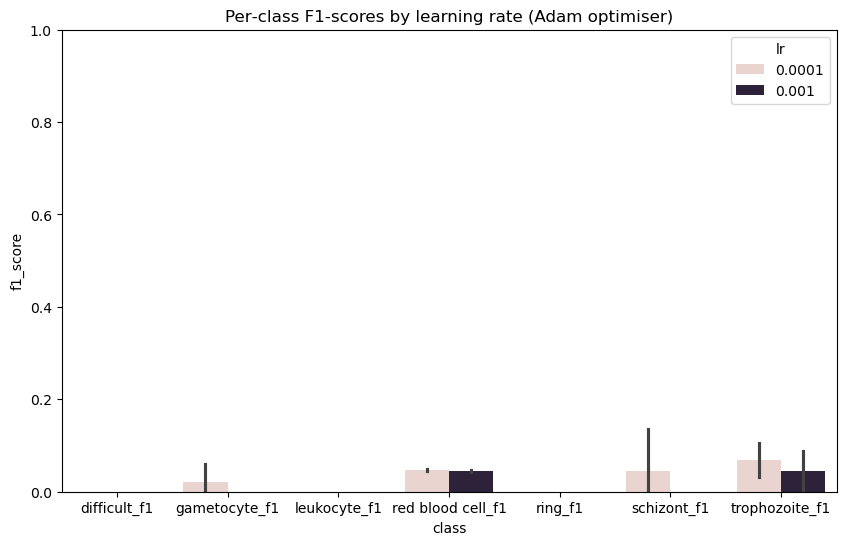

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter to a subset if there are many models
plot_df = summary_df[summary_df["optimizer"] == "Adam"]

# Melt the per-class F1 columns into long format
f1_cols = [f"{cls}_f1" for cls in class_names]
melted = plot_df.melt(
    id_vars=["lr", "batch_size", "sampling", "image_size"],
    value_vars=f1_cols,
    var_name="class",
    value_name="f1_score"
)

plt.figure(figsize=(10, 6))
sns.barplot(
    data=melted,
    x="class",
    y="f1_score",
    hue="lr"
)
plt.title("Per‑class F1‑scores by learning rate (Adam optimiser)")
plt.ylim(0, 1)
plt.show()


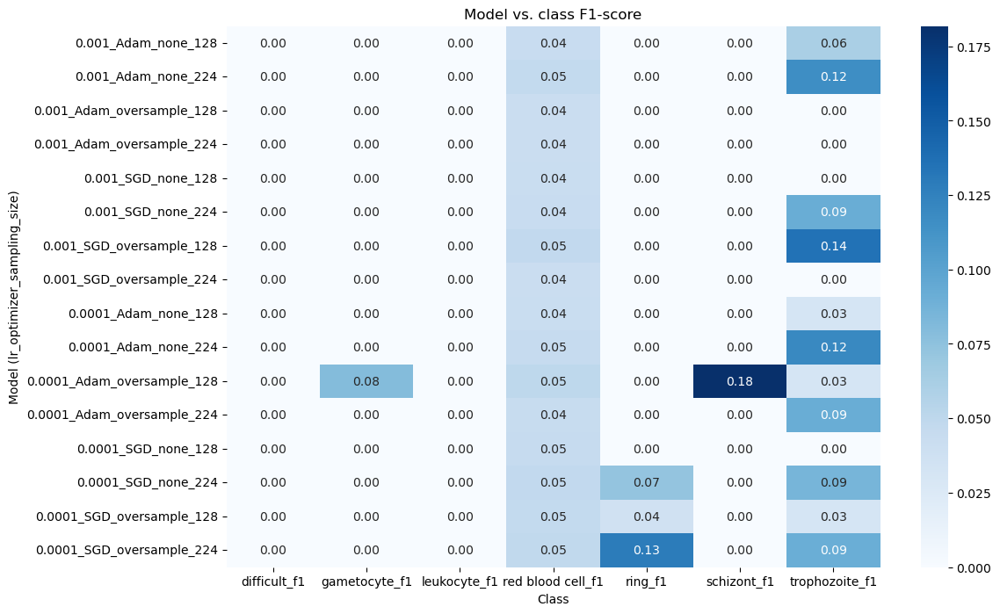

In [20]:
# Build a pivot table: rows = models, columns = class F1-scores
row_index = (summary_df["lr"].astype(str) + "_" +
             summary_df["optimizer"] + "_" +
             summary_df["sampling"] + "_" +
             summary_df["image_size"].astype(str))
heatmap_df = summary_df.set_index(row_index)[f1_cols]

plt.figure(figsize=(12, len(heatmap_df)/2))
sns.heatmap(heatmap_df, annot=True, fmt=".2f", cmap="Blues")
plt.title("Model vs. class F1-score")
plt.xlabel("Class")
plt.ylabel("Model (lr_optimizer_sampling_size)")
plt.show()


### Model prediction

In [21]:
# Create a single dictionary to hold all ground truth entries
all_entries_map = {}

# Populate the map from the training dataset
for entry in train_ds.entries:
    filename = os.path.basename(entry['image']['pathname'])
    all_entries_map[filename] = entry

# Add/overwrite with entries from the test dataset
for entry in test_ds.entries:
    filename = os.path.basename(entry['image']['pathname'])
    all_entries_map[filename] = entry

print(f"Created a lookup map with {len(all_entries_map)} total unique image entries.")

Created a lookup map with 1328 total unique image entries.


## Gradcam

In [22]:
class GradCAM:
    """
    A robust Grad-CAM class that properly manages and removes hooks.
    """
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        
        # Store hook handles to be able to remove them later
        self.handles = []
        self._register_hooks()

    def _capture_activations(self, module, input, output):
        self.activations = output.detach()

    def _capture_gradients(self, module, grad_in, grad_out):
        self.gradients = grad_out[0].detach()

    def _register_hooks(self):
        # Register hooks and store their handles
        handle_forward = self.target_layer.register_forward_hook(self._capture_activations)
        handle_backward = self.target_layer.register_full_backward_hook(self._capture_gradients)
        self.handles.extend([handle_forward, handle_backward])

    def remove_hooks(self):
        # Use the stored handles to remove the hooks
        for handle in self.handles:
            handle.remove()

    def generate_heatmap(self, model_output, class_idx):
        if class_idx is None:
            class_idx = model_output.argmax(dim=1)
        
        self.model.zero_grad()
        model_output[0, class_idx].backward(retain_graph=True)
        
        pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])
        
        for i in range(self.activations.shape[1]):
            self.activations[:, i, :, :] *= pooled_gradients[i]
            
        heatmap = torch.mean(self.activations, dim=1).squeeze().cpu()
        heatmap = F.relu(heatmap)
        heatmap /= (torch.max(heatmap) + 1e-8)
        
        return heatmap.numpy()

In [23]:
def visualize_prediction_with_gradcam(
    model, image_path, all_entries_map, device, class_names,
    model_name="", image_size=224, threshold=0.5
):
    """
    Performs a prediction on a single image, prints a summary of
    predicted vs. ground truth labels and infection status, and displays
    both the Grad-CAM heatmap and the ground-truth bounding boxes.
    """
    # Define which classes indicate infection
    parasite_classes = {"gametocyte", "trophozoite", "schizont", "ring"}

    target_layer = model.backbone.features[-1]
    grad_cam = GradCAM(model, target_layer)

    try:
        if model_name:
            print(f"\n### Model: {model_name} ###")
        print(f"--- Processing image: {os.path.basename(image_path)} ---")
        # Define which classes indicate infection
        print(f"--- Processing image: {os.path.basename(image_path)} ---")
        image_pil = Image.open(image_path).convert("RGB")
        transform = transforms.Compose([
            transforms.Resize((image_size, image_size)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])
        image_tensor = transform(image_pil).unsqueeze(0).to(device)

        model.eval()
        output = model(image_tensor)  # keep gradients enabled
        class_scores = output[0] if isinstance(output, tuple) else output

        # Aggregate over boxes if necessary
        if class_scores.dim() == 3:
            # sum scores over the box dimension -> shape (1, n_classes)
            class_scores_agg = class_scores.sum(dim=1)
        else:
            class_scores_agg = class_scores

        # Convert to probabilities and determine predicted labels
        probabilities = torch.sigmoid(class_scores_agg[0])
        predicted_indices = (probabilities >= threshold).nonzero(as_tuple=True)[0]
        predicted_labels = {class_names[i] for i in predicted_indices}

        # Sort probabilities for a readable breakdown
        all_scores = sorted(
            [(class_names[i], probabilities[i].item()) for i in range(len(class_names))],
            key=lambda x: x[1],
            reverse=True,
        )
        print("\n--- Prediction Breakdown ---")
        for cname, score in all_scores:
            print(f"  - {cname:<15}: {score*100:.2f}%")

        # Ground-truth extraction
        filename = os.path.basename(image_path)
        gt_entry = all_entries_map.get(filename)
        gt_labels = set()
        if gt_entry and gt_entry.get("objects"):
            gt_labels = {obj["category"] for obj in gt_entry["objects"]}
        print("\n--- Ground Truth Breakdown ---")
        if gt_entry and gt_entry.get("objects"):
            freqs = Counter(obj["category"] for obj in gt_entry["objects"])
            for cname, cnt in freqs.most_common():
                print(f"  - {cname:<15}: {cnt}")
        else:
            print("  - No ground truth objects listed for this image.")

        # Infection status
        predicted_status = "Infected" if predicted_labels & parasite_classes else "Not Infected"
        actual_status = "Infected" if gt_labels & parasite_classes else "Not Infected"
        diagnosis_correct = predicted_status == actual_status

        print("\n--- Final Diagnosis ---")
        print(f"Model Diagnosis: {predicted_status} | Actual Status: {actual_status}")

        # Comparison of labels
        true_positives = predicted_labels & gt_labels
        false_positives = predicted_labels - gt_labels
        false_negatives = gt_labels - predicted_labels
        print("\n--- Prediction Summary ---")
        print(f"Correctly Predicted: {', '.join(true_positives) if true_positives else 'None'}")
        print(f"Missed: {', '.join(false_negatives) if false_negatives else 'None'}")
        print(f"Incorrectly Predicted: {', '.join(false_positives) if false_positives else 'None'}")

        # Grad-CAM for the top class
        top_class_idx = probabilities.argmax().item()
        top_class_name = class_names[top_class_idx]
        print(f"\nGenerating Grad-CAM for the top prediction: '{top_class_name}'")
        heatmap = grad_cam.generate_heatmap(class_scores_agg, class_idx=top_class_idx)

        # Prepare heatmap overlay
        heatmap_resized = cv2.resize(heatmap, (image_pil.width, image_pil.height))
        heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)
        heatmap_colored = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
        image_np = np.array(image_pil)
        overlay_img = cv2.addWeighted(image_np, 0.6, heatmap_colored, 0.4, 0)

        # When plotting, you can set a suptitle or include model_name in the subplot title
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))
        # Left-hand title includes the model name and the top class
        left_title = f"{model_name}\nGrad-CAM: '{top_class_name}' ({probabilities[top_class_idx]*100:.2f}%)"
        ax1.imshow(overlay_img)
        ax1.set_title(left_title, color="green" if diagnosis_correct else "red")
        ax1.axis("off")
        if predicted_labels:
            ax1.text(0.02, 0.98, "Predicted Classes:\n" + "\n".join(f"- {c}" for c in sorted(predicted_labels)),
                     transform=ax1.transAxes, fontsize=10, va="top",
                     bbox=dict(boxstyle="round", facecolor="limegreen", alpha=0.6))

        # Right: Ground truth boxes and labels
        ax2.imshow(image_np)
        ax2.set_title(f"Ground Truth: {actual_status}")
        ax2.axis("off")
        if gt_entry and gt_entry.get("objects"):
            for obj in gt_entry["objects"]:
                bb = obj["bounding_box"]
                rect = patches.Rectangle(
                    (bb["minimum"]["c"], bb["minimum"]["r"]),
                    bb["maximum"]["c"] - bb["minimum"]["c"],
                    bb["maximum"]["r"] - bb["minimum"]["r"],
                    linewidth=2, edgecolor="gold", facecolor="none"
                )
                ax2.add_patch(rect)
                ax2.text(bb["minimum"]["c"], bb["minimum"]["r"] - 10,
                         obj["category"], color="black", fontsize=8,
                         bbox=dict(facecolor="gold", alpha=0.7, edgecolor="none"))

        plt.tight_layout()
        plt.show()

    finally:
        grad_cam.remove_hooks()


C:\Users\shera\AppData\Local\Temp\ipykernel_25632\1405784319.py:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=device)



### Model: model_lr_0.001_optim_Adam_sampling_none_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 80.61%
  - ring           : 58.19%
  - trophozoite    : 53.43%
  - schizont       : 52.41%
  - difficult      : 51.88%
  - gametocyte     : 40.77%
  - leukocyte      : 38.73%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: None

Generating Grad-CAM for the top prediction: 'red blood cell'


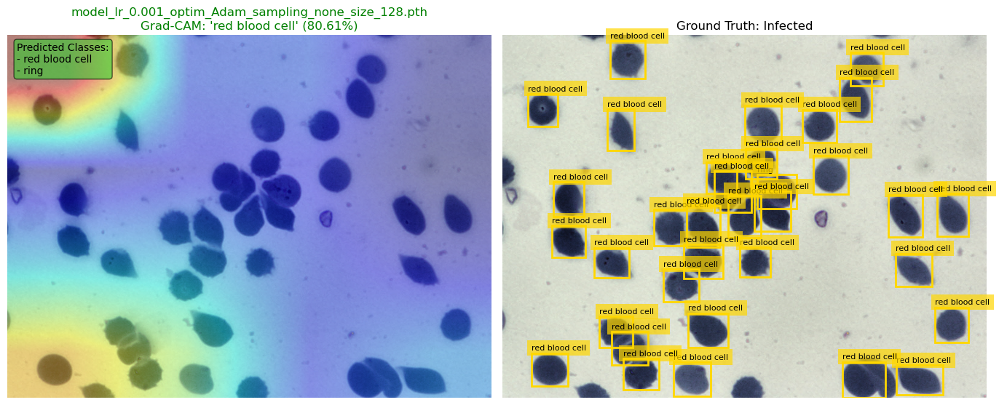


### Model: model_lr_0.001_optim_Adam_sampling_none_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 66.05%
  - ring           : 64.62%
  - leukocyte      : 57.72%
  - trophozoite    : 55.55%
  - schizont       : 54.27%
  - difficult      : 48.55%
  - gametocyte     : 42.63%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite, leukocyte

Generating Grad-CAM for the top prediction: 'red blood cell'


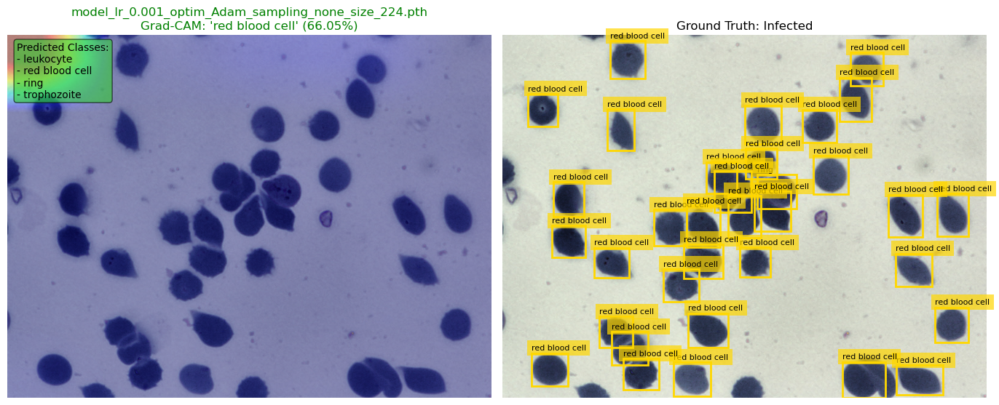


### Model: model_lr_0.001_optim_Adam_sampling_oversample_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 66.24%
  - ring           : 60.97%
  - trophozoite    : 57.77%
  - difficult      : 51.88%
  - schizont       : 49.69%
  - gametocyte     : 49.43%
  - leukocyte      : 43.18%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite

Generating Grad-CAM for the top prediction: 'red blood cell'


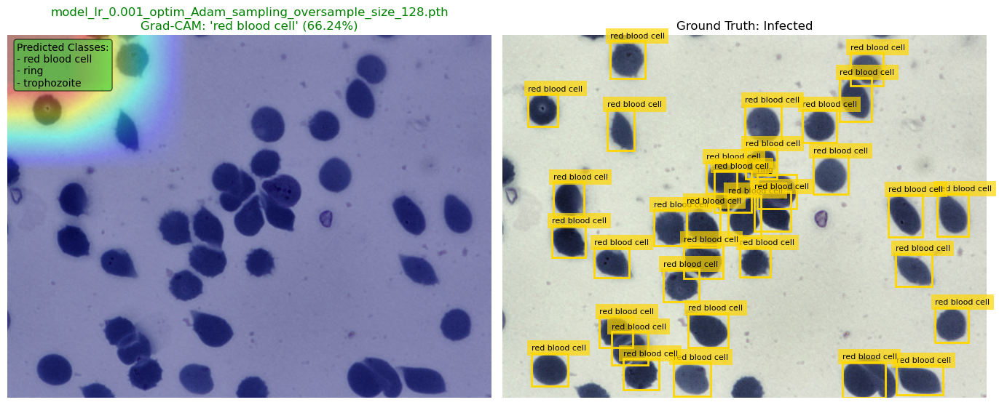


### Model: model_lr_0.001_optim_Adam_sampling_oversample_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - ring           : 62.22%
  - red blood cell : 61.34%
  - leukocyte      : 60.59%
  - difficult      : 57.46%
  - trophozoite    : 50.17%
  - schizont       : 47.48%
  - gametocyte     : 33.11%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: leukocyte, difficult

Generating Grad-CAM for the top prediction: 'ring'


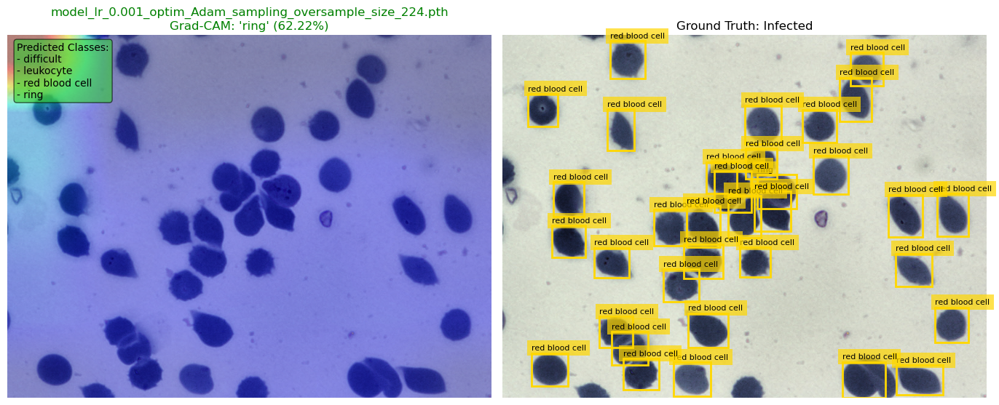


### Model: model_lr_0.001_optim_SGD_sampling_none_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 77.43%
  - trophozoite    : 58.96%
  - difficult      : 54.03%
  - ring           : 50.26%
  - schizont       : 45.49%
  - gametocyte     : 44.69%
  - leukocyte      : 43.69%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell
Missed: ring
Incorrectly Predicted: trophozoite

Generating Grad-CAM for the top prediction: 'red blood cell'


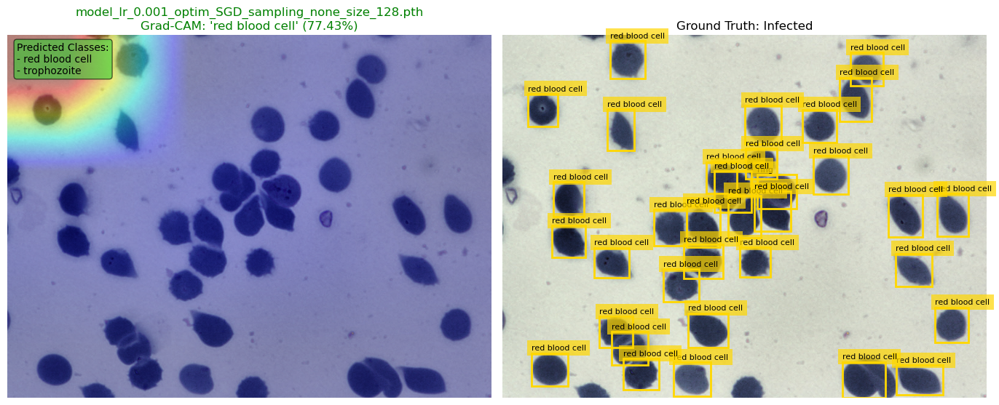


### Model: model_lr_0.001_optim_SGD_sampling_none_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 68.90%
  - gametocyte     : 57.07%
  - difficult      : 55.31%
  - schizont       : 48.37%
  - ring           : 46.27%
  - trophozoite    : 45.83%
  - leukocyte      : 45.69%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell
Missed: ring
Incorrectly Predicted: gametocyte, difficult

Generating Grad-CAM for the top prediction: 'red blood cell'


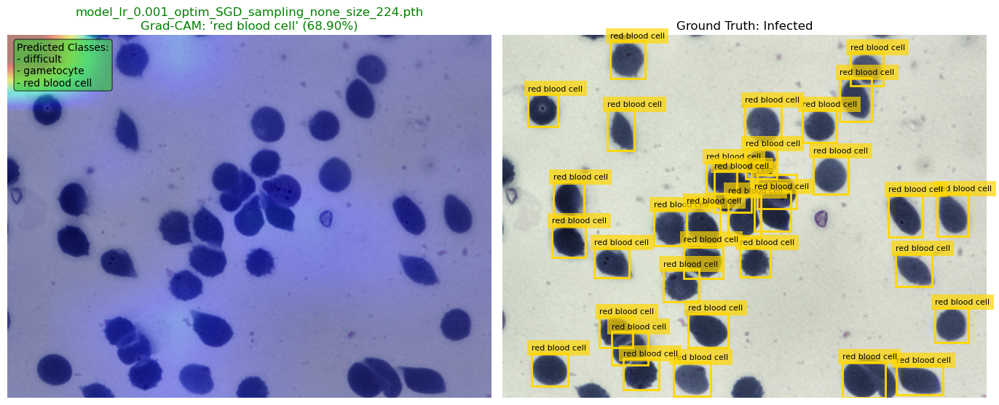


### Model: model_lr_0.001_optim_SGD_sampling_oversample_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 66.04%
  - ring           : 58.29%
  - gametocyte     : 53.97%
  - trophozoite    : 50.26%
  - leukocyte      : 49.77%
  - schizont       : 45.70%
  - difficult      : 44.34%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: None

Generating Grad-CAM for the top prediction: 'red blood cell'


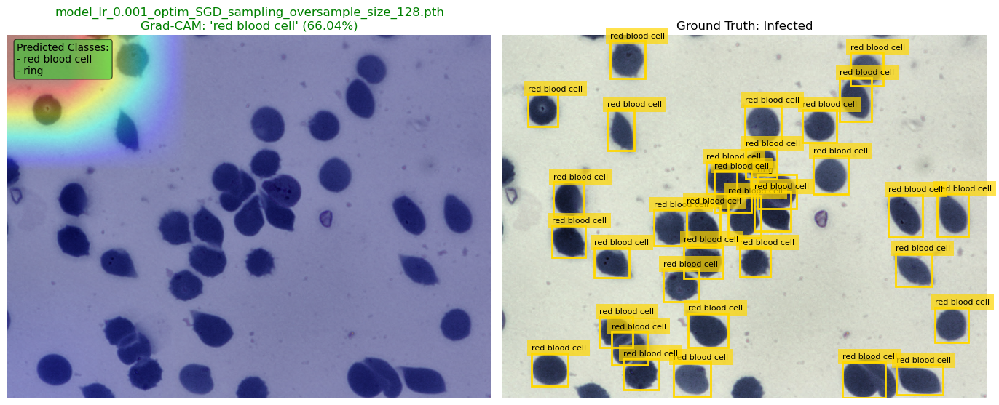


### Model: model_lr_0.001_optim_SGD_sampling_oversample_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 63.07%
  - trophozoite    : 55.70%
  - ring           : 52.53%
  - schizont       : 49.59%
  - gametocyte     : 47.97%
  - difficult      : 46.55%
  - leukocyte      : 44.46%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell
Missed: ring
Incorrectly Predicted: trophozoite

Generating Grad-CAM for the top prediction: 'red blood cell'


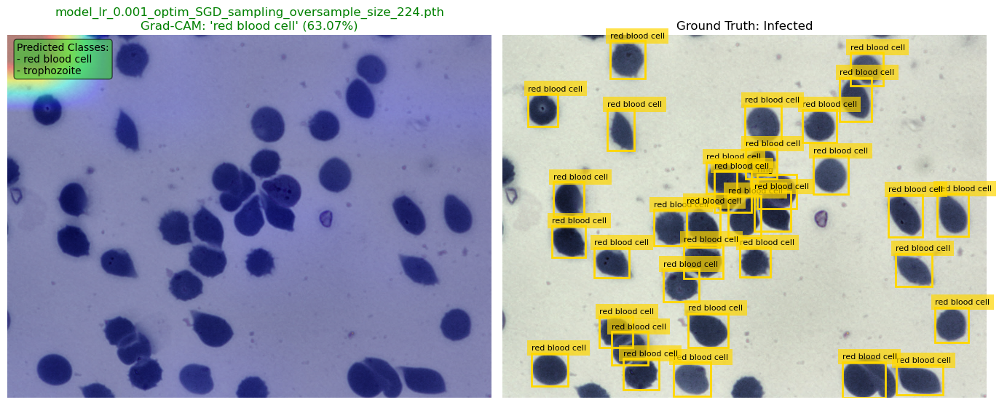


### Model: model_lr_0.0001_optim_Adam_sampling_none_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - difficult      : 61.54%
  - schizont       : 59.53%
  - gametocyte     : 58.76%
  - leukocyte      : 54.21%
  - trophozoite    : 53.00%
  - red blood cell : 52.29%
  - ring           : 48.41%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: None
Missed: red blood cell, ring
Incorrectly Predicted: schizont, gametocyte, difficult

Generating Grad-CAM for the top prediction: 'difficult'


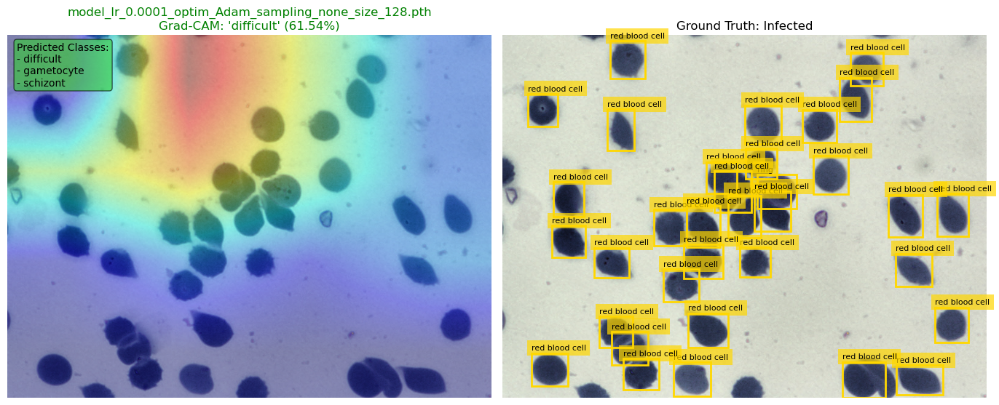


### Model: model_lr_0.0001_optim_Adam_sampling_none_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 64.13%
  - ring           : 61.22%
  - trophozoite    : 56.39%
  - difficult      : 54.40%
  - schizont       : 52.21%
  - gametocyte     : 50.03%
  - leukocyte      : 48.32%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite

Generating Grad-CAM for the top prediction: 'red blood cell'


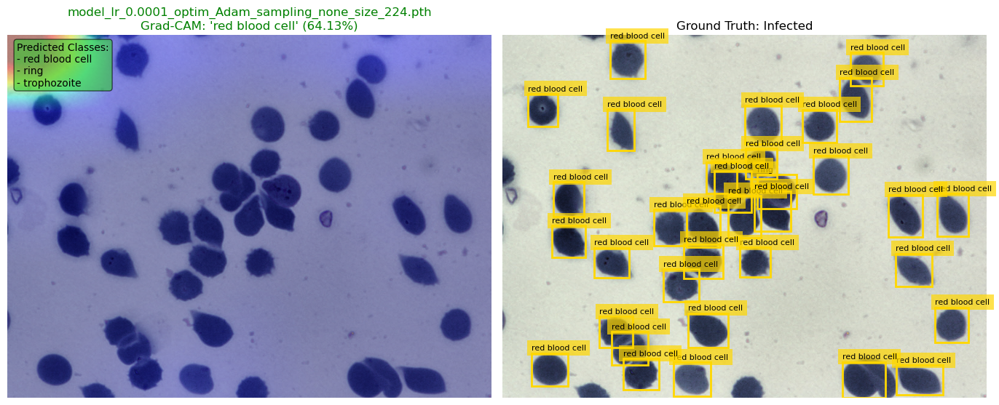


### Model: model_lr_0.0001_optim_Adam_sampling_oversample_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - ring           : 62.77%
  - red blood cell : 60.47%
  - schizont       : 60.13%
  - gametocyte     : 56.70%
  - difficult      : 56.64%
  - trophozoite    : 56.55%
  - leukocyte      : 53.42%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite, gametocyte, schizont, difficult

Generating Grad-CAM for the top prediction: 'ring'


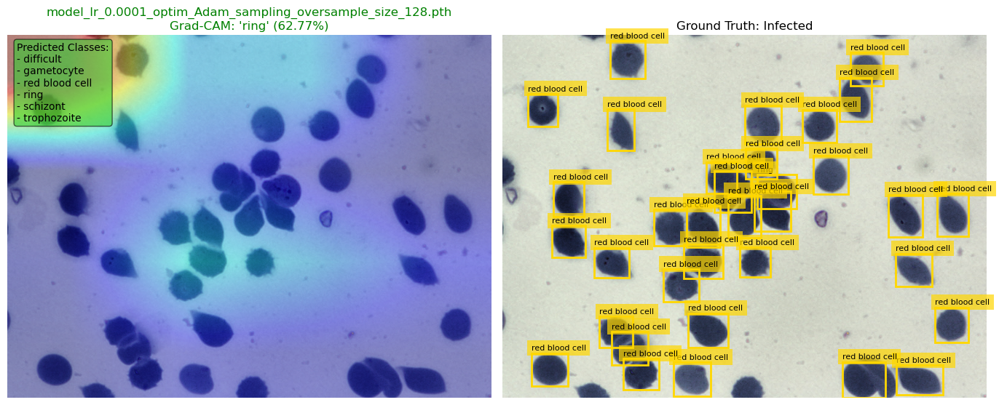


### Model: model_lr_0.0001_optim_Adam_sampling_oversample_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 68.44%
  - gametocyte     : 59.58%
  - ring           : 55.33%
  - trophozoite    : 55.12%
  - difficult      : 54.95%
  - leukocyte      : 53.77%
  - schizont       : 52.69%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite, gametocyte

Generating Grad-CAM for the top prediction: 'red blood cell'


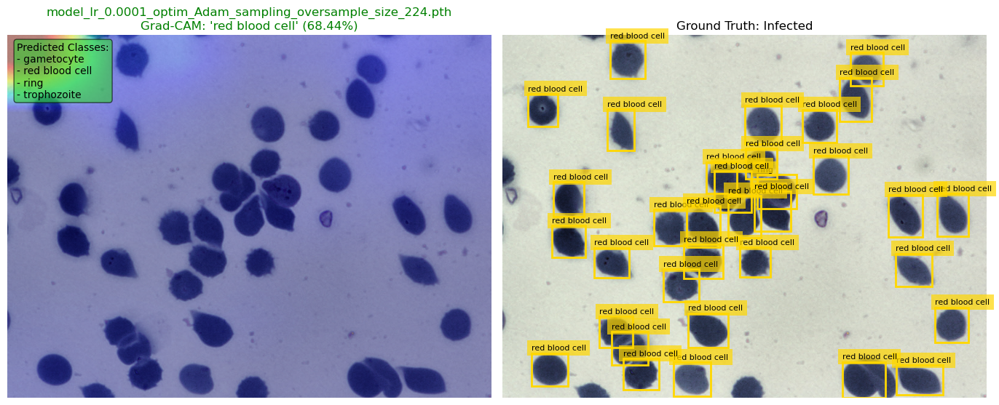


### Model: model_lr_0.0001_optim_SGD_sampling_none_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - schizont       : 59.95%
  - difficult      : 59.61%
  - red blood cell : 59.35%
  - trophozoite    : 56.07%
  - ring           : 53.64%
  - leukocyte      : 52.12%
  - gametocyte     : 50.47%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell
Missed: ring
Incorrectly Predicted: schizont, trophozoite, difficult

Generating Grad-CAM for the top prediction: 'schizont'


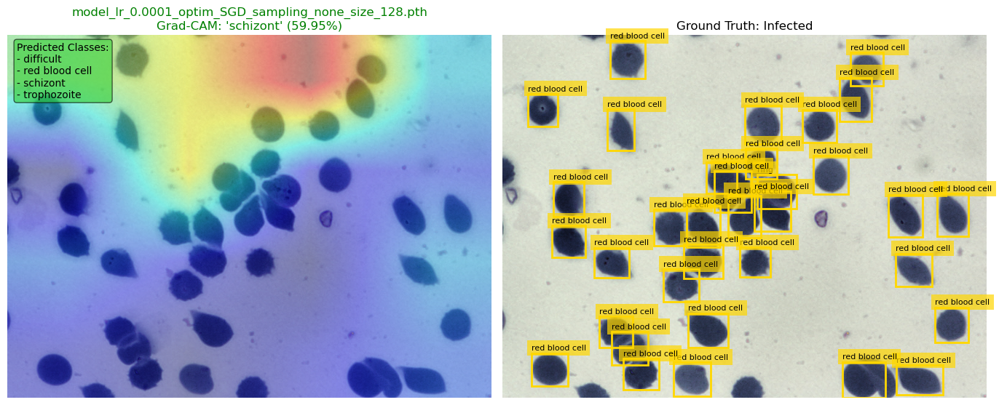


### Model: model_lr_0.0001_optim_SGD_sampling_none_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 58.32%
  - ring           : 56.60%
  - leukocyte      : 56.43%
  - gametocyte     : 54.28%
  - trophozoite    : 51.38%
  - difficult      : 48.87%
  - schizont       : 45.59%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: leukocyte

Generating Grad-CAM for the top prediction: 'red blood cell'


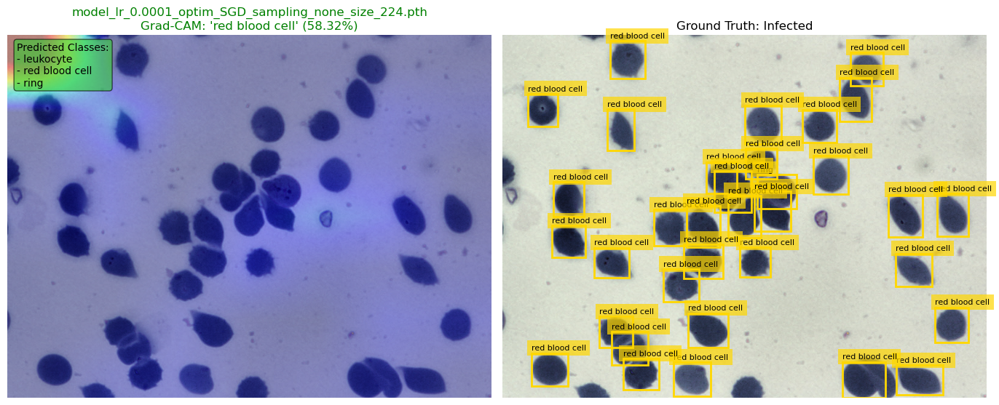


### Model: model_lr_0.0001_optim_SGD_sampling_oversample_size_128.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - ring           : 66.22%
  - trophozoite    : 61.29%
  - red blood cell : 60.75%
  - leukocyte      : 60.74%
  - schizont       : 54.99%
  - difficult      : 52.48%
  - gametocyte     : 45.28%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell, ring
Missed: None
Incorrectly Predicted: trophozoite, leukocyte

Generating Grad-CAM for the top prediction: 'ring'


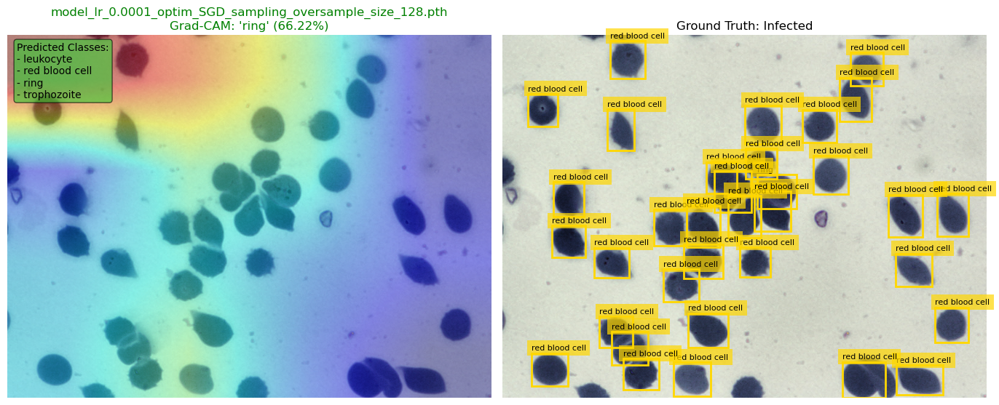


### Model: model_lr_0.0001_optim_SGD_sampling_oversample_size_224.pth ###
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---
--- Processing image: 0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png ---

--- Prediction Breakdown ---
  - red blood cell : 60.27%
  - trophozoite    : 59.71%
  - gametocyte     : 55.00%
  - difficult      : 54.03%
  - ring           : 51.95%
  - schizont       : 47.33%
  - leukocyte      : 46.32%

--- Ground Truth Breakdown ---
  - red blood cell : 33
  - ring           : 1

--- Final Diagnosis ---
Model Diagnosis: Infected | Actual Status: Infected

--- Prediction Summary ---
Correctly Predicted: red blood cell
Missed: ring
Incorrectly Predicted: trophozoite, gametocyte

Generating Grad-CAM for the top prediction: 'red blood cell'


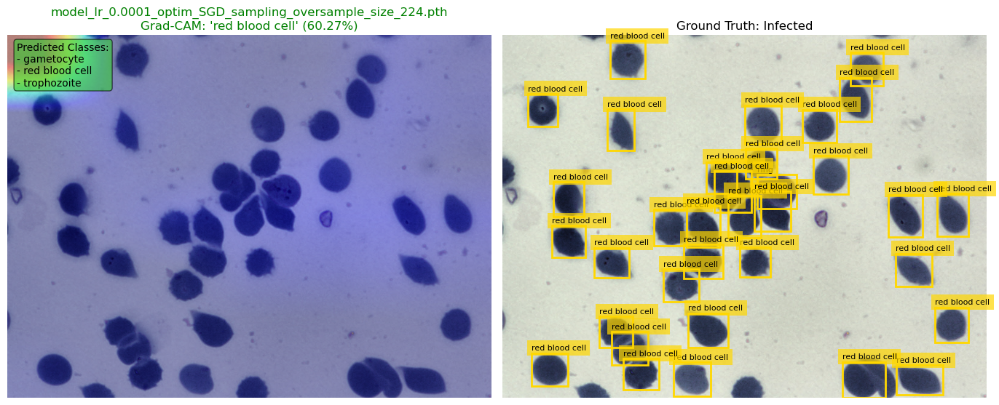

In [24]:
my_image_path = os.path.join(image_path, '0b04ec46-5119-4cda-8c35-c4e5b6f0eed0.png')

for entry in aggregated_results:
    params = entry["params"]
    sampling_str = params.get("sampling") or "none"
    model_file = (
        f"model_lr_{params['lr']}_optim_{params['optimizer']}_"
        f"sampling_{sampling_str}_size_{params['image_size']}.pth"
    )
    model_path = os.path.join(models_dir, model_file)
    if not os.path.isfile(model_path):
        continue

    model = EfficientNetDetector(num_classes=num_classes).to(device)
    checkpoint = torch.load(model_path, map_location=device)
    model.load_state_dict(checkpoint["model_state_dict"])
    model.eval()

    visualize_prediction_with_gradcam(
        model=model,
        image_path=my_image_path,
        all_entries_map=all_entries_map,
        device=device,
        class_names=class_names,
        model_name=model_file,        # pass the filename as the model label
        image_size=params["image_size"],
        threshold=0.55
    )
